## Sim Demo

### Imports

In [270]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [271]:
from env.imports import *

In [272]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

#### Check job specs

In [273]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 51.3%
RAM Usage: 14.7%
Available RAM: 321.5G
Total RAM: 377.1G
52.4G


In [274]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


None
Available GPUs: 0


### Data viz

In [275]:
from data.data_load import load_transcriptome, load_connectome, load_coords, load_network_labels
from data.data_viz import plot_connectome, plot_transcriptome
from data.data_utils import expand_X_symmetric, expand_Y_symmetric

In [276]:
import netneurotools
from netneurotools.datasets import fetch_schaefer2018
from netneurotools.plotting import plot_fsaverage
from netneurotools import datasets as nndata
import nibabel as nib
from netneurotools import freesurfer as nnsurf
from netneurotools import stats as nnstats
from netneurotools.plotting import plot_point_brain


In [277]:
from scipy.optimize import curve_fit
from scipy.stats import binned_statistic
from scipy.spatial import distance
from scipy.spatial.distance import cdist
from scipy import stats
from numpy.polynomial import Polynomial

In [278]:
X = load_transcriptome(parcellation='S400', hemisphere='both', omit_subcortical=False, sort_genes='expression', impute_strategy='mirror_interpolate')
Y = load_connectome(parcellation='S400', hemisphere='both', omit_subcortical=False)
coords = load_coords(parcellation='S400', hemisphere='both', omit_subcortical=False)
labels, network_labels = load_network_labels(parcellation='S400', hemisphere='both', omit_subcortical=False)

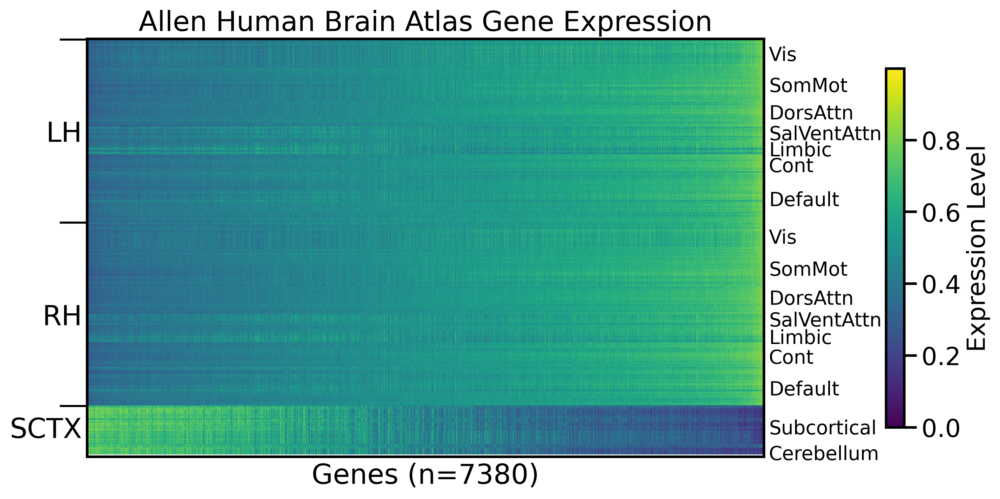

In [279]:
plot_transcriptome(null_model='none', parcellation='S400', hemisphere='both', omit_subcortical=False, gene_list='0.2', sort_genes='expression', impute_strategy='mirror_interpolate') #, add_hemisphere_labels=True, add_network_labels=False)

spinning gene expression


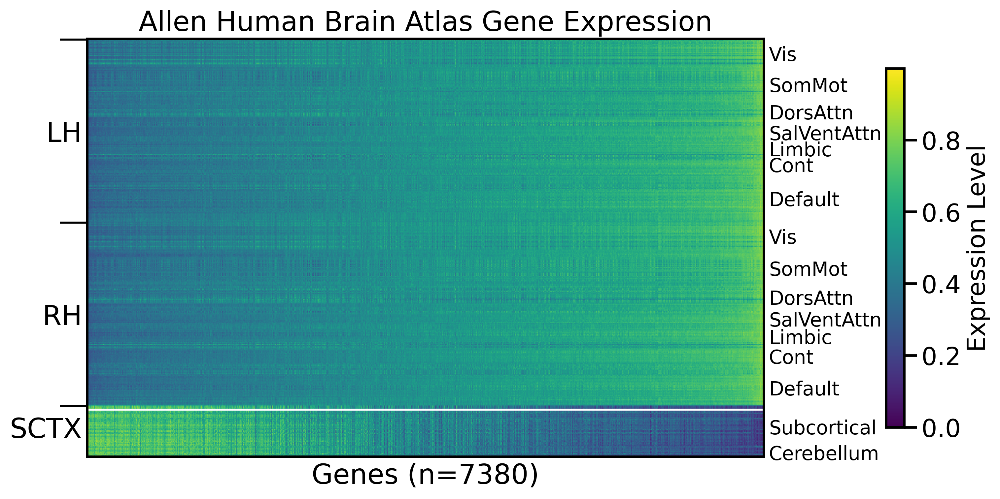

In [280]:
plot_transcriptome(null_model='spin', parcellation='S400', hemisphere='both', omit_subcortical=False, gene_list='0.2', sort_genes='expression', impute_strategy='mirror_interpolate') #, add_hemisphere_labels=True, add_network_labels=False)

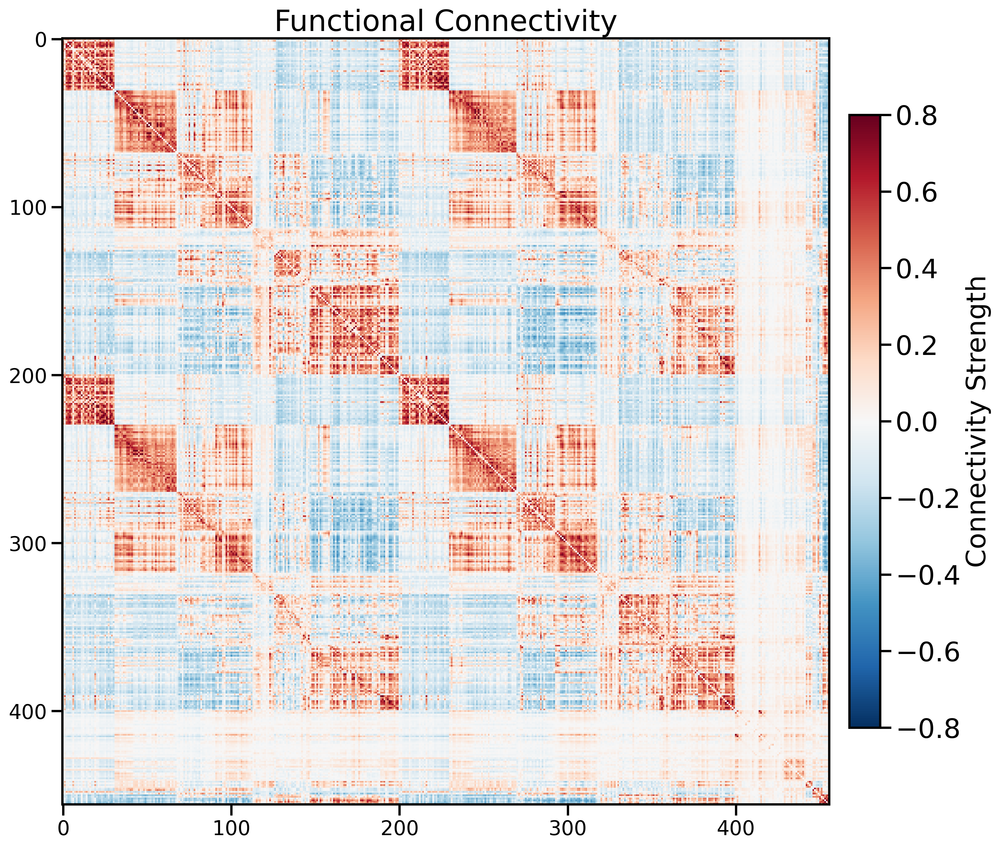

In [281]:
plot_connectome(parcellation='S400', hemisphere='both', measure='FC', omit_subcortical=False, add_network_labels=False)

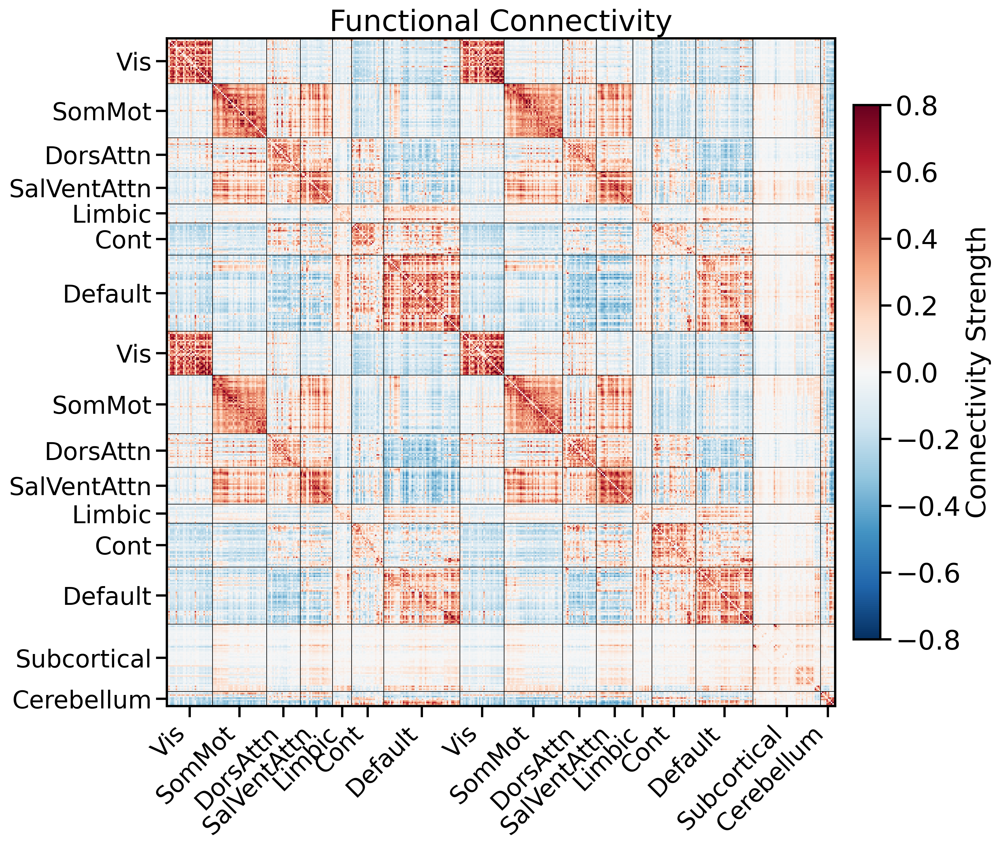

In [282]:
plot_connectome(parcellation='S400', hemisphere='both', measure='FC', omit_subcortical=False, add_network_labels=True)

### Spatial autocorr analysis

#### Overall data loading

In [283]:
def load_and_plot_data(parcellation='S400', hemisphere='both', omit_subcortical=False, 
                      sort_genes='expression', impute_strategy='mirror_interpolate', 
                      null_model='none', fontsize=16):
    # Load data
    X = load_transcriptome(parcellation=parcellation, hemisphere=hemisphere, 
                          omit_subcortical=omit_subcortical, sort_genes=sort_genes,
                          impute_strategy=impute_strategy, null_model=null_model)
    Y = load_connectome(parcellation=parcellation, hemisphere=hemisphere,
                       omit_subcortical=omit_subcortical)
    coords = load_coords(parcellation=parcellation, hemisphere=hemisphere,
                        omit_subcortical=omit_subcortical)
    labels, network_labels = load_network_labels(parcellation=parcellation,
                                               hemisphere=hemisphere,
                                               omit_subcortical=omit_subcortical)

    # Filter valid data
    valid_indices = ~np.isnan(X).all(axis=1)
    X = X[valid_indices]

    X_pca = load_transcriptome(run_PCA=True, parcellation=parcellation,
                              hemisphere=hemisphere, omit_subcortical=omit_subcortical,
                              sort_genes=sort_genes, impute_strategy=impute_strategy, null_model=null_model)
    X_pca = X_pca[valid_indices]
    Y = Y[valid_indices][:, valid_indices]

    coords = coords[valid_indices]
    labels = [labels[i] for i in range(len(labels)) if valid_indices[i]]
    network_labels = network_labels[valid_indices]

    # Compute correlation matrices
    X_corr = np.corrcoef(X, rowvar=True)
    X_pca_corr = np.corrcoef(X_pca, rowvar=True)

    # Compute distance matrix
    dist_matrix = cdist(coords, coords)

    # Create visualization
    fig, axes = plt.subplots(1, 4, figsize=(40, 8))

    # Plot X correlations
    im0 = axes[0].imshow(X_corr, cmap='RdBu_r', vmin=-1, vmax=1)
    axes[0].set_title('Gene Expression Correlations', fontsize=fontsize)
    plt.colorbar(im0, ax=axes[0])
    axes[0].tick_params(axis='both', which='major', labelsize=fontsize-2)

    # Plot X PCA correlations
    im1 = axes[1].imshow(X_pca_corr, cmap='RdBu_r', vmin=-1, vmax=1)
    axes[1].set_title('PCA Gene Expression Correlations', fontsize=fontsize)
    plt.colorbar(im1, ax=axes[1])
    axes[1].tick_params(axis='both', which='major', labelsize=fontsize-2)

    # Plot distance matrix
    im2 = axes[2].imshow(dist_matrix, cmap='viridis')
    axes[2].set_title('Euclidean Distances', fontsize=fontsize)
    plt.colorbar(im2, ax=axes[2])
    axes[2].tick_params(axis='both', which='major', labelsize=fontsize-2)

    # Plot Y matrix
    im3 = axes[3].imshow(Y, cmap='RdBu_r', vmin=-0.8, vmax=0.8)
    axes[3].set_title('Connectivity', fontsize=fontsize)
    plt.colorbar(im3, ax=axes[3])
    axes[3].tick_params(axis='both', which='major', labelsize=fontsize-2)

    plt.tight_layout()
    plt.show()

    return X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix

#### Curve fitting

In [284]:
# Define exponential decay function
def exp_decay(x, SA_inf, SA_lambda):
    """    
    Parameters
    ----------
    x : array-like
        Distance values (in mm)
    SA_inf : float
        Asymptotic value of functional connectivity at infinite distance
    SA_lambda : float
        Decay constant controlling rate of exponential decay
        
    Returns
    -------
    float or array-like
        Predicted values following exponential decay
    """
    return SA_inf + (1 - SA_inf) * np.exp(-x / SA_lambda)

def plot_distance_decay(features, y_feature='FC', bin_size_mm=5, coverage='Full Brain'):
    """Plot distance decay relationship between a feature and distance.
    
    Parameters
    ----------
    features : dict
        Dictionary containing 'distances' and feature arrays (e.g., 'FC', 'CGE', 'PCA_CGE')
    y_feature : str, optional
        Name of feature to plot on y-axis, by default 'FC'
    bin_size_mm : float, optional
        Size of distance bins in mm, by default 5
    coverage : str, optional
        Region of brain being analyzed ('Full Brain', 'Cortex', or 'Subcortex'), by default 'Full Brain'
    """
    # Create distance bins
    bin_edges = np.arange(0, max(features['distances']) + bin_size_mm, bin_size_mm)

    # Calculate binned statistics
    bin_means, bin_edges, _ = stats.binned_statistic(features['distances'], features[y_feature], 
                                             statistic='mean', bins=bin_edges)
    bin_std, _, _ = stats.binned_statistic(features['distances'], features[y_feature], 
                                   statistic='std', bins=bin_edges)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

    # Fit exponential decay
    popt, _ = curve_fit(exp_decay, bin_centers, bin_means,
                      p0=[0, 10], bounds=([-1, 0], [1, 100]), maxfev=5000)

    # Generate fit curve
    x_fit = np.linspace(min(features['distances']), max(features['distances']), 100)
    y_fit = exp_decay(x_fit, *popt)

    # Create plot
    plt.figure(figsize=(12,8))

    # Get y-axis label based on feature
    if y_feature == 'FC':
        y_label = 'Functional Connectivity (FC)'
    elif y_feature == 'CGE':
        y_label = 'Correlated Gene Expression (CGE)'
    elif y_feature == 'PCA_CGE':
        y_label = 'PCA CGE'
    else:
        y_label = y_feature.replace('_', ' ').title()

    plt.bar(bin_centers, bin_means, width=bin_size_mm, color='#808080', alpha=0.6)
    plt.scatter(features['distances'], features[y_feature], color='gray', 
               alpha=0.1, s=0.8)
    plt.errorbar(bin_centers, bin_means, yerr=bin_std, color='black', fmt='o',
                markersize=2, capsize=1, linewidth=0.5,
                label=f"Mean {y_label} ({bin_size_mm}mm bins)")
    plt.plot(x_fit, y_fit, "r-", linewidth=2.5, label="Exp Decay Fit")
    plt.axvline(x=popt[1], color='green', linestyle='--', alpha=0.2)

    # Add SA parameters text
    sa_text = f'SA-λ = {popt[1]:.3f}\nSA-∞ = {popt[0]:.3f}'
    plt.text(0.95, 0.75, sa_text, transform=plt.gca().transAxes,
            bbox=dict(facecolor='white', alpha=0.8),
            horizontalalignment='right', verticalalignment='bottom',
            fontsize=18)

    plt.xlabel('Distance (mm)', fontsize=18)
    plt.ylabel(y_label, fontsize=18)
    plt.title(f'Distance vs {y_label} ({coverage})', fontsize=20)
    plt.tick_params(axis='both', which='major', labelsize=16)
    plt.legend(fontsize=16)

    plt.tight_layout()
    plt.show()


def plot_distance_decay_poly3(features, y_feature='FC', bin_size_mm=5, coverage='Full Brain'):
    """Plot distance decay using a 3rd order polynomial fit.

    Parameters
    ----------
    features : dict
        Dictionary containing 'distances' and feature arrays (e.g., 'FC', 'CGE', 'PCA_CGE')
    y_feature : str, optional
        Name of feature to plot on y-axis, by default 'FC'
    bin_size_mm : float, optional
        Size of distance bins in mm, by default 5
    coverage : str, optional
        Region of brain being analyzed ('Full Brain', 'Cortex', or 'Subcortex'), by default 'Full Brain'
    """
    # Create distance bins
    bin_edges = np.arange(0, max(features['distances']) + bin_size_mm, bin_size_mm)

    # Calculate binned statistics
    bin_means, bin_edges, _ = stats.binned_statistic(features['distances'], features[y_feature], 
                                                     statistic='mean', bins=bin_edges)
    bin_std, _, _ = stats.binned_statistic(features['distances'], features[y_feature], 
                                           statistic='std', bins=bin_edges)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

    # Remove NaNs (may occur if a bin is empty)
    valid = ~np.isnan(bin_means)
    bin_centers = bin_centers[valid]
    bin_means = bin_means[valid]
    bin_std = bin_std[valid]

    # Fit a 3rd order polynomial
    poly3 = Polynomial.fit(bin_centers, bin_means, deg=3)
    coefs = poly3.convert().coef  # Convert to standard basis to extract raw coefficients

    x_fit = np.linspace(min(features['distances']), max(features['distances']), 100)
    y_fit = poly3(x_fit)

    # Create plot
    plt.figure(figsize=(12, 8))

    if y_feature == 'FC':
        y_label = 'Functional Connectivity (FC)'
    elif y_feature == 'CGE':
        y_label = 'Correlated Gene Expression (CGE)'
    elif y_feature == 'PCA_CGE':
        y_label = 'PCA CGE'
    else:
        y_label = y_feature.replace('_', ' ').title()

    plt.bar(bin_centers, bin_means, width=bin_size_mm, color='#808080', alpha=0.6)
    plt.scatter(features['distances'], features[y_feature], color='gray', alpha=0.1, s=0.8)
    plt.errorbar(bin_centers, bin_means, yerr=bin_std, color='black', fmt='o',
                 markersize=2, capsize=1, linewidth=0.5,
                 label=f"Mean {y_label} ({bin_size_mm}mm bins)")
    plt.plot(x_fit, y_fit, "darkorange", linewidth=2.5, label="3rd Order Polynomial Fit")

    # Add polynomial coefficients to plot
    coef_text = '\n'.join([
        f"$a_3$ = {coefs[3]:.4e}",
        f"$a_2$ = {coefs[2]:.4e}",
        f"$a_1$ = {coefs[1]:.4e}",
        f"$a_0$ = {coefs[0]:.4e}",
    ])
    plt.text(0.05, 0.05, coef_text, transform=plt.gca().transAxes,
             bbox=dict(facecolor='white', alpha=0.8),
             horizontalalignment='left', verticalalignment='bottom',
             fontsize=14)

    plt.xlabel('Distance (mm)', fontsize=18)
    plt.ylabel(y_label, fontsize=18)
    plt.title(f'Distance vs {y_label} ({coverage})', fontsize=20)
    plt.tick_params(axis='both', which='major', labelsize=16)
    plt.legend(fontsize=16)

    plt.tight_layout()
    plt.show()

def plot_distance_fits(features, y_feature, bin_size_mm=10, coverage='Full Brain'):
    """
    Plot distance relationships with exponential decay, polynomial and linear fits
    
    Args:
        features (dict): Dictionary containing distances and feature values
        y_feature (str): Feature to plot ('FC', 'CGE', or 'PCA_CGE')
        bin_size_mm (float): Size of distance bins in mm
        coverage (str): Brain coverage description for title
    """
    # Calculate binned statistics
    bins = np.arange(0, max(features['distances']) + bin_size_mm, bin_size_mm)
    bin_centers = bins[:-1] + bin_size_mm/2
    bin_means, _, _ = stats.binned_statistic(features['distances'], 
                                           features[y_feature], 
                                           statistic='mean', 
                                           bins=bins)
    bin_std, _, _ = stats.binned_statistic(features['distances'], 
                                          features[y_feature], 
                                          statistic='std', 
                                          bins=bins)
    valid = ~np.isnan(bin_means)
    bin_centers = bin_centers[valid]
    bin_means = bin_means[valid]
    bin_std = bin_std[valid]

    # Fit models
    # 3rd order polynomial
    poly3 = Polynomial.fit(bin_centers, bin_means, deg=3)
    poly_coefs = poly3.convert().coef
    # Exponential decay
    exp_params, _ = curve_fit(exp_decay, bin_centers, bin_means,
                           p0=[0, 10], bounds=([-1, 0], [1, 100]), maxfev=5000)
    
    # Linear fit
    linear = np.polyfit(bin_centers, bin_means, 1)
    
    # Generate fit lines
    x_fit = np.linspace(min(features['distances']), max(features['distances']), 100)
    y_poly = poly3(x_fit)
    y_exp = exp_decay(x_fit, *exp_params)
    y_linear = linear[0] * x_fit + linear[1]

    # Create plot
    fig, ax = plt.subplots(figsize=(12, 8))
    # Set y-axis label based on feature type
    if y_feature == 'FC':
        y_label = 'Functional Connectivity (FC)'
    elif y_feature == 'CGE':
        y_label = 'Correlated Gene Expression (CGE)'
    elif y_feature == 'PCA_CGE':
        y_label = 'PCA CGE'
    else:
        y_label = y_feature.replace('_', ' ').title()

    # Plot raw data and binned statistics
    plt.bar(bin_centers, bin_means, width=bin_size_mm, color='#808080', alpha=0.6)
    plt.scatter(features['distances'], features[y_feature], color='gray', alpha=0.1, s=0.8)
    plt.errorbar(bin_centers, bin_means, yerr=bin_std, color='black', fmt='o',
                 markersize=2, capsize=1, linewidth=0.5,
                 label=f"Mean {y_label} ({bin_size_mm}mm bins)")

    # Plot fits
    plt.plot(x_fit, y_poly, "darkorange", linewidth=2.5, label="3rd Order Polynomial")
    plt.plot(x_fit, y_exp, "red", linewidth=2.5, label="Exponential Decay")
    plt.plot(x_fit, y_linear, "blue", linewidth=2.5, label="Linear Fit")

    plt.xlabel('Distance (mm)', fontsize=18)
    plt.ylabel(y_label, fontsize=18)
    plt.title(f'Distance vs {y_label} ({coverage})', fontsize=20)
    plt.tick_params(axis='both', which='major', labelsize=16)
    plt.legend(fontsize=16, loc='upper right')

    # Add fit parameters text box outside plot
    param_text = (
        "Fit Parameters:\n\n"
        "Polynomial:\n"
        f"$a_3$ = {poly_coefs[3]:.2e}\n"
        f"$a_2$ = {poly_coefs[2]:.2e}\n"
        f"$a_1$ = {poly_coefs[1]:.2e}\n"
        f"$a_0$ = {poly_coefs[0]:.2e}\n\n"
        "Exponential:\n"
        f"SA-∞ = {exp_params[0]:.3f}\n"
        f"SA-λ = {exp_params[1]:.3f}\n\n"
        "Linear:\n"
        f"slope = {linear[0]:.2e}\n"
        f"intercept = {linear[1]:.2e}"
    )
    
    plt.figtext(1.02, 0.5, param_text, fontsize=14, 
                bbox=dict(facecolor='white', alpha=0.8),
                va='center')

    plt.tight_layout()
    plt.show()

#### Subsetting brain data to full brain, cortex, subcortex

In [285]:
def subset_brain_data(X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix):
    # subset all to valid indices
    valid_indices = ~np.isnan(X).all(axis=1)
    X = X[valid_indices]
    X_pca = X_pca[valid_indices]
    Y = Y[valid_indices][:, valid_indices]
    coords = coords[valid_indices]
    labels = [labels[i] for i in range(len(labels)) if valid_indices[i]]
    network_labels = network_labels[valid_indices]

    # Get upper triangular indices (excluding diagonal)
    triu_indices = np.triu_indices(X_corr.shape[0], k=1)
    X_corr_vec = X_corr[triu_indices]
    X_pca_vec = X_pca_corr[triu_indices]
    dist_vec = dist_matrix[triu_indices] 
    Y_vec = Y[triu_indices]

    # Create features dictionary with distances and fc values
    features = {
        'distances': dist_vec,
        'CGE': X_corr_vec,
        'FC': Y_vec,
        'PCA_CGE': X_pca_vec
    }
    # Separate cortical data
    n = (X.shape[0] // 100) * 100  # Hacky way to retain only cortical regions by rounding down to nearest hundred
    X_cortex = X[:n]
    X_cortex_pca = X_pca[:n] 
    Y_cortex = Y[:n, :n]
    coords_cortex = coords[:n]
    labels_cortex = labels[:n]
    network_labels_cortex = network_labels[:n]

    # Calculate cortical correlations
    X_cortex_corr = np.corrcoef(X_cortex, rowvar=True)
    X_cortex_pca_corr = np.corrcoef(X_cortex_pca, rowvar=True)

    # compute distance matrix of coords
    dist_cortex_matrix = cdist(coords_cortex, coords_cortex)

    # Get upper triangular indices for cortex (excluding diagonal)
    triu_indices_cortex = np.triu_indices(X_cortex_corr.shape[0], k=1)
    X_cortex_corr_vec = X_cortex_corr[triu_indices_cortex]
    X_cortex_pca_corr_vec = X_cortex_pca_corr[triu_indices_cortex]
    dist_vec_cortex = dist_cortex_matrix[triu_indices_cortex]
    Y_cortex_vec = Y_cortex[triu_indices_cortex]

    # Create features dictionary for cortex
    features_cortex = {
        'distances': dist_vec_cortex,
        'CGE': X_cortex_corr_vec, 
        'FC': Y_cortex_vec,
        'PCA_CGE': X_cortex_pca_corr_vec
    }
    # Separate subcortical data
    X_subcortex = X[n:]
    X_subcortex_pca = X_pca[n:]
    Y_subcortex = Y[n:, n:]
    coords_subcortex = coords[n:]
    labels_subcortex = labels[n:]
    network_labels_subcortex = network_labels[n:]

    # Calculate subcortical correlations
    X_subcortex_corr = np.corrcoef(X_subcortex, rowvar=True)
    X_subcortex_pca_corr = np.corrcoef(X_subcortex_pca, rowvar=True)

    # compute distance matrix of coords
    dist_subcortex_matrix = cdist(coords_subcortex, coords_subcortex)

    # Get upper triangular indices for subcortex (excluding diagonal)
    triu_indices_subcortex = np.triu_indices(X_subcortex_corr.shape[0], k=1)
    X_subcortex_corr_vec = X_subcortex_corr[triu_indices_subcortex]
    X_subcortex_pca_corr_vec = X_subcortex_pca_corr[triu_indices_subcortex]
    dist_vec_subcortex = dist_subcortex_matrix[triu_indices_subcortex]
    Y_subcortex_vec = Y_subcortex[triu_indices_subcortex]

    # Create features dictionary for subcortex
    features_subcortex = {
        'distances': dist_vec_subcortex,
        'CGE': X_subcortex_corr_vec, 
        'FC': Y_subcortex_vec,
        'PCA_CGE': X_subcortex_pca_corr_vec
    }
    
    return features, features_cortex, features_subcortex

Number of components for 95% variance PCA: 27


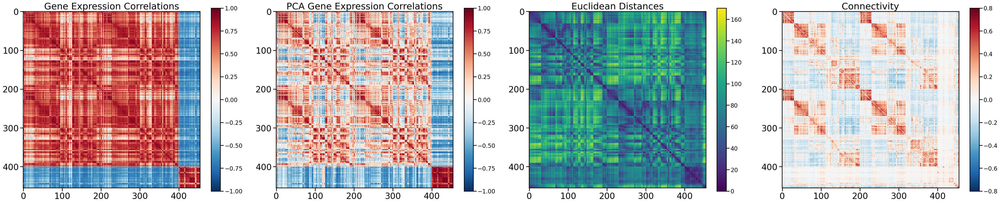

In [286]:
X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix = load_and_plot_data(parcellation='S400', hemisphere='both', omit_subcortical=False, 
                      sort_genes='expression', impute_strategy='mirror_interpolate', null_model='none', fontsize=26)

features, features_cortex, features_subcortex = subset_brain_data(X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix)

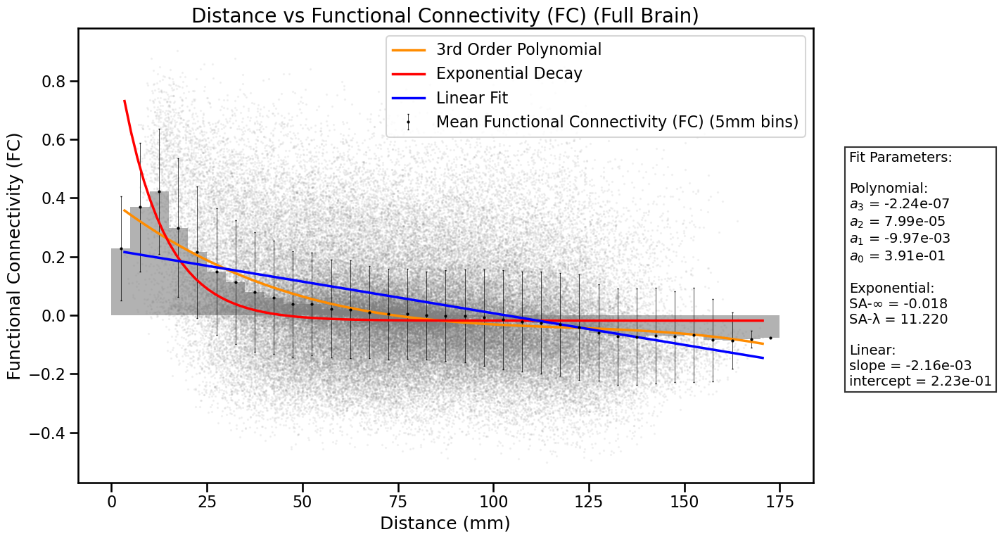

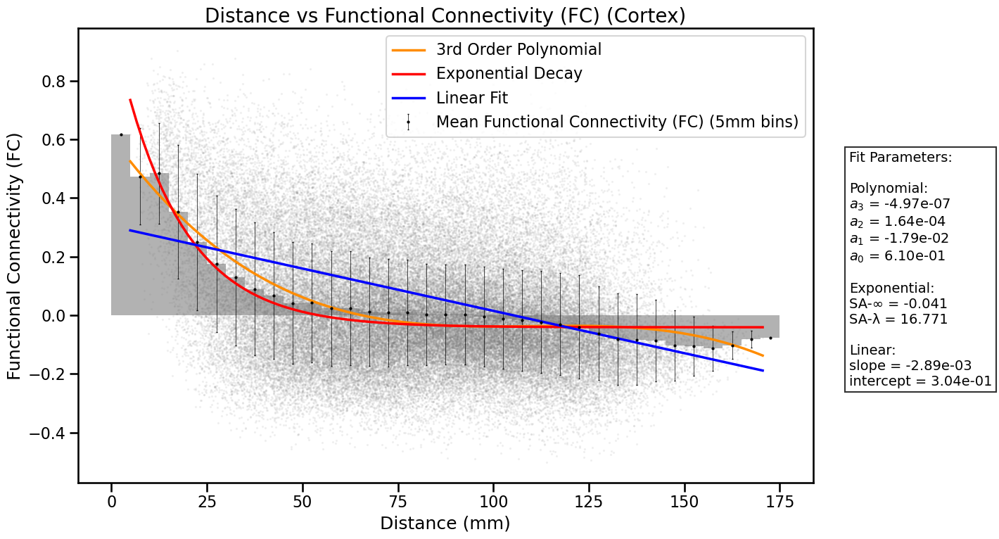

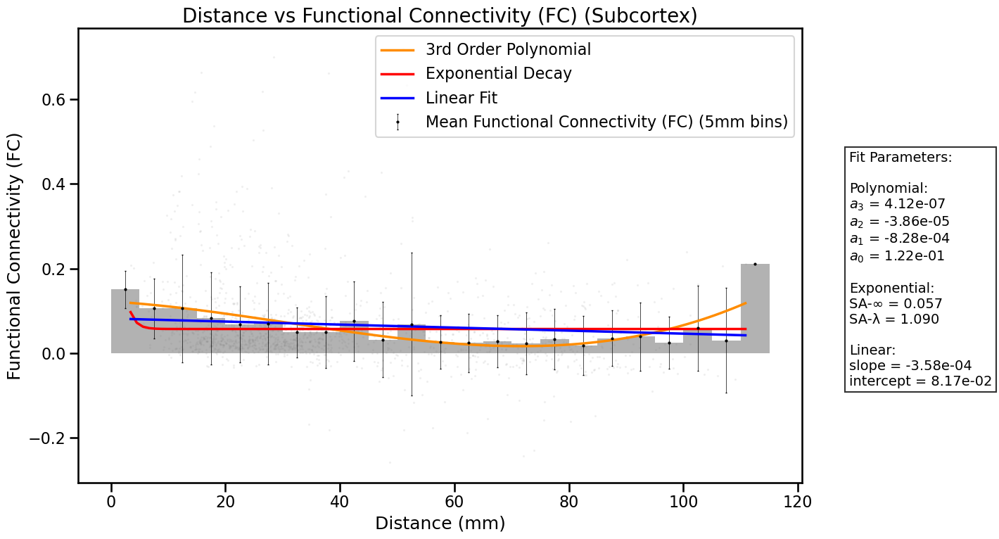

In [287]:
plot_distance_fits(features, 'FC', 5, 'Full Brain')
plot_distance_fits(features_cortex, 'FC', 5, 'Cortex')
plot_distance_fits(features_subcortex, 'FC', 5, 'Subcortex')

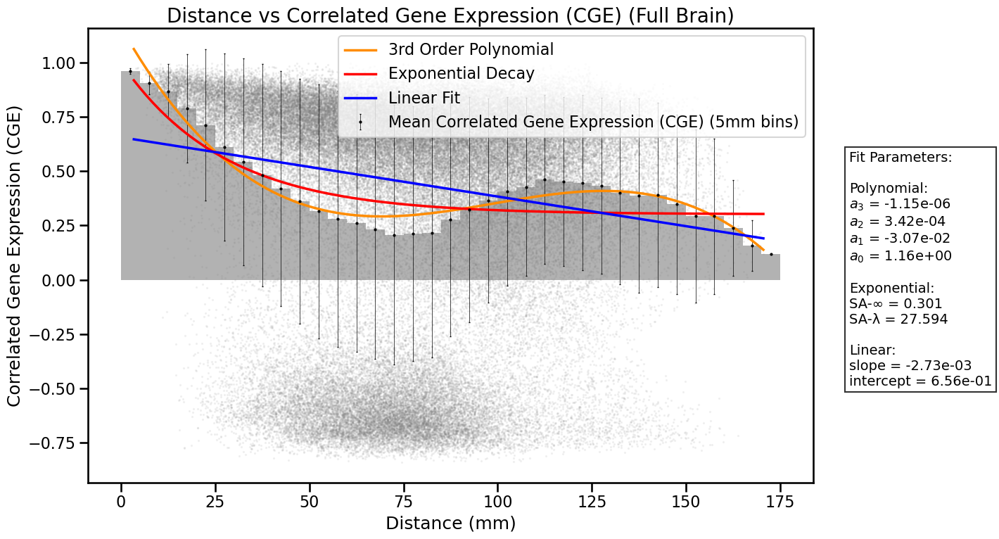

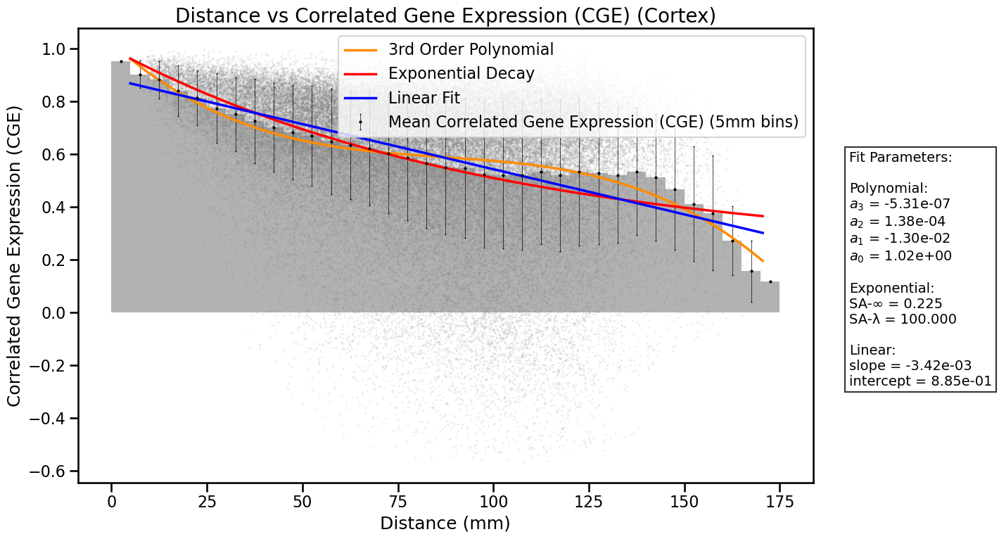

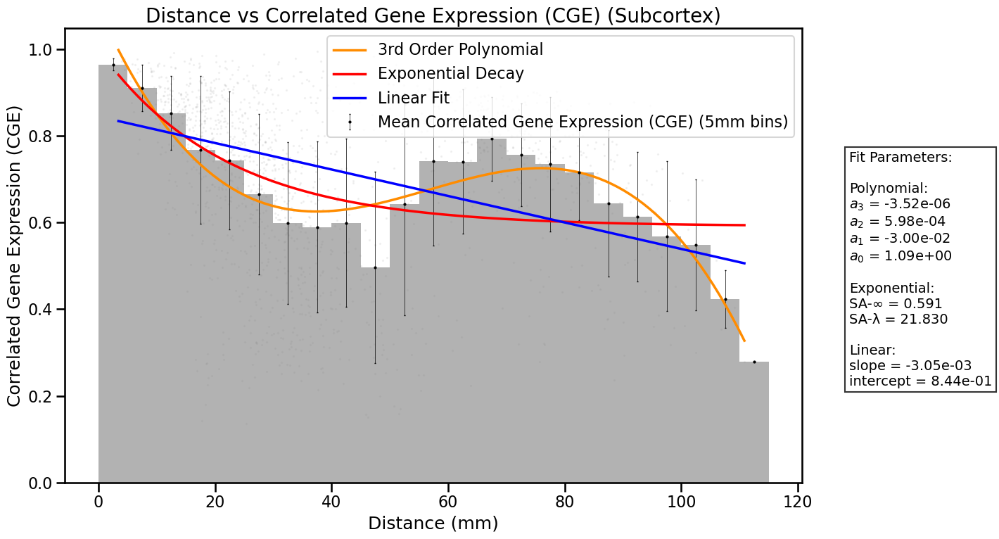

In [288]:
plot_distance_fits(features, 'CGE', 5, 'Full Brain')
plot_distance_fits(features_cortex, 'CGE', 5, 'Cortex')
plot_distance_fits(features_subcortex, 'CGE', 5, 'Subcortex')


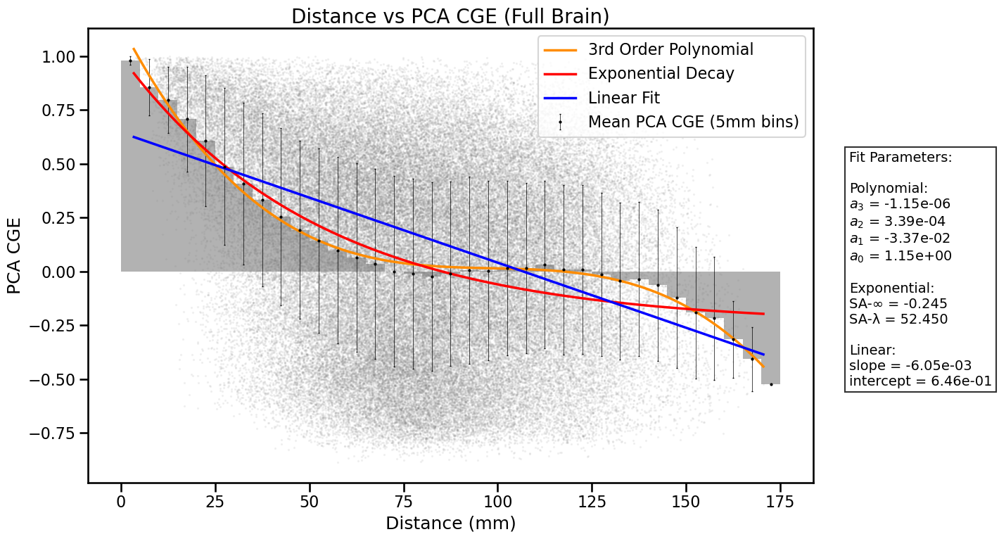

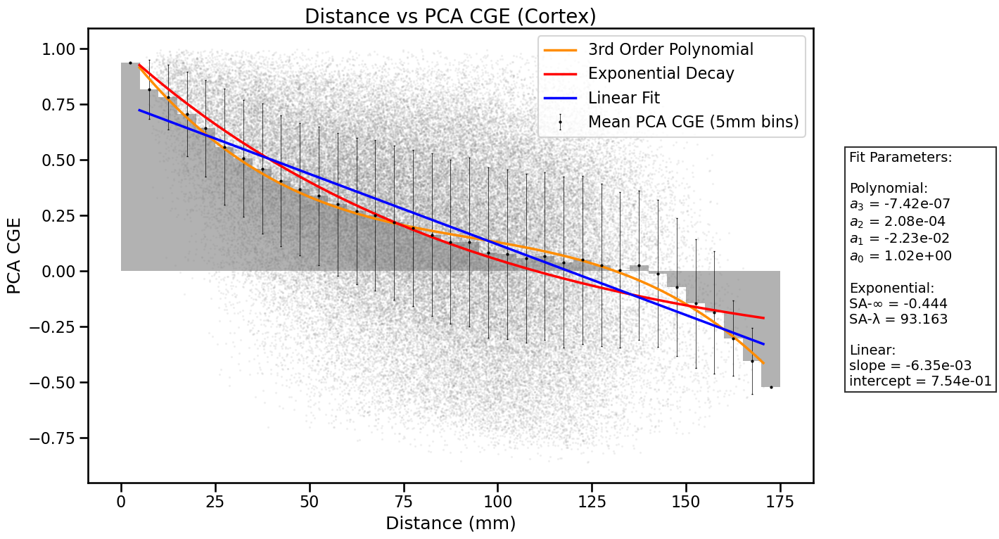

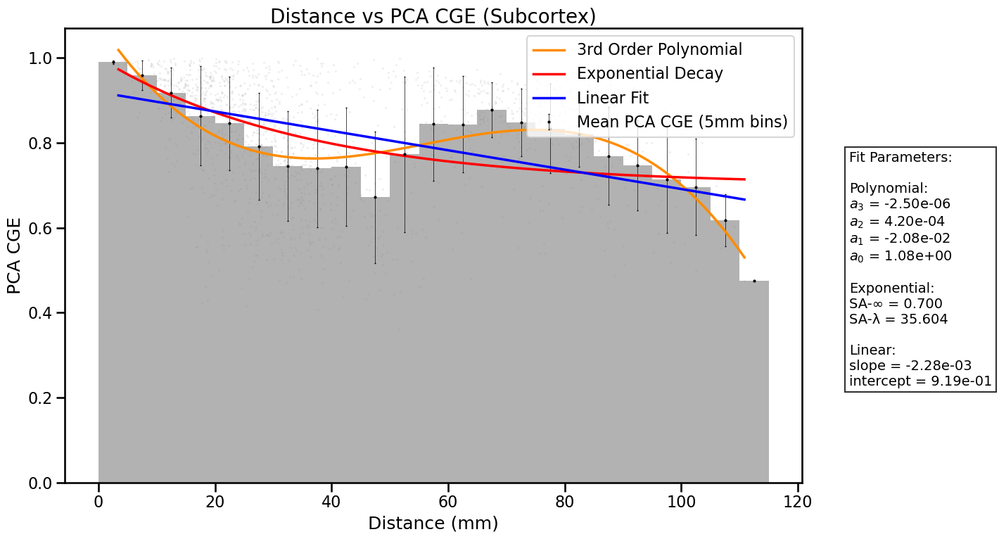

In [289]:
plot_distance_fits(features, 'PCA_CGE', 5, 'Full Brain')
plot_distance_fits(features_cortex, 'PCA_CGE', 5, 'Cortex')
plot_distance_fits(features_subcortex, 'PCA_CGE', 5, 'Subcortex')

### Create null spin tests

In [309]:
genes_data, valid_genes = load_transcriptome(parcellation='S400', 
                                             gene_list='0.2',
                                             run_PCA=False, 
                                             omit_subcortical=False, 
                                             hemisphere='both', 
                                             impute_strategy='mirror_interpolate', 
                                             sort_genes='expression', 
                                             return_valid_genes=True, null_model='none', random_seed=42)

genes_data_PCA = load_transcriptome(parcellation='S400', 
                                             gene_list='0.2',
                                             run_PCA=True, 
                                             omit_subcortical=False, 
                                             hemisphere='both', 
                                             impute_strategy='mirror_interpolate', 
                                             sort_genes='expression', 
                                             return_valid_genes=False, null_model='none', random_seed=42)

all_region_coords = load_coords(parcellation='S400', omit_subcortical=False)

# https://netneurotools.readthedocs.io/en/stable/generated/netneurotools.freesurfer.find_parcel_centroids.html#netneurotools.freesurfer.find_parcel_centroids
lh_annot, rh_annot = nndata.fetch_schaefer2018('fsaverage', data_dir='data/UKBB', verbose=1)['400Parcels7Networks']
# https://netneurotools.readthedocs.io/en/stable/generated/netneurotools.stats.gen_spinsamples.html
coords, hemi = nnsurf.find_parcel_centroids(lhannot=lh_annot, rhannot=rh_annot, version='fsaverage', surf='sphere')
# (method=original (Bloch) may give duplicates; Vasa, Hungarian will not)
cortical_spins, cortical_cost = nnstats.gen_spinsamples(coords, hemi, n_rotate=1000, seed=42, method='vasa',return_cost=True)

num_cortical_regions = (genes_data.shape[0] // 100) * 100
cortical_genes_data = genes_data[:num_cortical_regions]
cortical_genes_data_PCA = genes_data_PCA[:num_cortical_regions]
subcortical_genes_data = genes_data[num_cortical_regions:]
subcortical_genes_data_PCA = genes_data_PCA[num_cortical_regions:]
subcortical_coords = all_region_coords[num_cortical_regions:]
x_coords = subcortical_coords[:, 0]
hemi_subcort = np.zeros_like(x_coords) # create mask for subcortical hemisphere
hemi_subcort[x_coords > 0] = 1

subcortical_spins, subcortical_cost = nnstats.gen_spinsamples(subcortical_coords, hemi_subcort, n_rotate=1000, seed=42, method='vasa', return_cost=True)

#cortical_genes_data_spun = genes_data[:num_cortical_regions][spin_indices]
#subcortical_genes_data_spun = subcortical_genes_data[subcortical_spins[:, 0]]
#genes_data = np.vstack([cortical_genes_data_spun, subcortical_genes_data_spun])

valid genes ['CRNDE', 'ECEL1', 'CHRNA3', 'RSPO4', 'TTR', 'RGS8', 'CA12', 'GINS3', 'KLHL13', 'S100PBP', 'PARD3B', 'PDE3A', 'SIX3', 'SCIN', 'NHSL1', 'BTN2A2', 'PIRT', 'RAB2B', 'SMIM30', 'DRD2', 'LONRF3', 'CYB5R3', 'SLITRK6', 'ELP4', 'HEYL', 'PKNOX1', 'GPRIN2', 'LHX8', 'MEGF11', 'C10orf105', 'AUTS2', 'PDIA3', 'PDIA3P1', 'CPNE3', 'TMEM255A', 'TMEM215', 'CYP7B1', 'IL13RA2', 'GPR75', 'TEAD1', 'KCNE5', 'PDLIM5', 'STAT1', 'C6orf118', 'CYLD', 'BAG3', 'TTPA', 'PINLYP', 'PCDH15', 'PREX2', 'PLXDC2', 'RASL12', 'DERL1', 'SCN7A', 'ARHGAP36', 'DNAJC12', 'AKIRIN2', 'ACVR1', 'ENKUR', 'NPL', 'FLVCR1', 'SAMD11', 'DNAH9', 'ADIPOR1', 'COL8A2', 'MAP3K1', 'LOC100233156', 'ADARB2-AS1', 'PFKFB3', 'SDC2', 'DAB2', 'CASC2', 'RGS22', 'PHKA1', 'HEY2', 'CENPVL3', 'PTGER3', 'CCDC85C', 'YBX3', 'PRSS35', 'VANGL1', 'PLXNA3', 'GLUD1', 'SSR1', 'MLF1', 'FAM210B', 'SERPINB1', 'WDR1', 'CFLAR', 'SZRD1', 'DAPL1', 'SPATA18', 'STK33', 'CFAP61', 'MAML2', 'DIRC2', 'ZNF516', 'MINK1', 'FAM111A', 'LINC01485', 'SCN9A', 'LINC00886', 'CX

In [310]:
cortical_spin_indices_T = cortical_spins.T
print(cortical_spin_indices_T.shape)
subcortical_spin_indices_T = subcortical_spins.T
print(subcortical_spin_indices_T.shape)


(1000, 400)
(1000, 56)


In [311]:
# Create a single DataFrame with both cortical and subcortical spin indices
spins_df = pd.DataFrame({
    'cortical_spins': cortical_spin_indices_T.tolist(),
    'subcortical_spins': subcortical_spin_indices_T.tolist()
})

print("Combined spins DataFrame shape:", spins_df.shape)

Combined spins DataFrame shape: (1000, 2)


In [312]:
cortical_cost_T = cortical_cost.T
print(cortical_cost_T.shape)
subcortical_cost_T = subcortical_cost.T
print(subcortical_cost_T.shape)

subcortical_cost_sum = subcortical_cost_T.sum(axis=1)
print(subcortical_cost_sum.shape)

cortical_cost_sum = cortical_cost_T.sum(axis=1)
print(cortical_cost_sum.shape)

total_cost = subcortical_cost_sum + cortical_cost_sum
print(total_cost.shape)

# Add cost columns to spins_df
spins_df['cortical_cost'] = cortical_cost_sum
spins_df['subcortical_cost'] = subcortical_cost_sum 
spins_df['total_cost'] = total_cost



(1000, 400)
(1000, 56)
(1000,)
(1000,)
(1000,)


In [313]:
print("Column types:")
print(spins_df.dtypes)

Column types:
cortical_spins        object
subcortical_spins     object
cortical_cost        float64
subcortical_cost     float64
total_cost           float64
dtype: object


In [314]:
spins_df

,cortical_spins,subcortical_spins,cortical_cost,subcortical_cost,total_cost
0,"[34, 35, 33, 102, 101, 99, 140, 152, 100, 174,...","[53, 52, 49, 51, 54, 50, 33, 34, 42, 48, 29, 4...",14676.201766,2342.839271,17019.041037
1,"[31, 33, 135, 171, 162, 154, 35, 98, 158, 101,...","[32, 55, 53, 52, 31, 51, 8, 34, 6, 54, 10, 50,...",14223.071041,3079.720650,17302.791691
2,"[165, 166, 124, 167, 114, 125, 133, 119, 113, ...","[54, 55, 32, 46, 48, 50, 3, 29, 5, 31, 30, 34,...",14066.498745,2193.130687,16259.629432
3,"[48, 106, 110, 109, 55, 199, 179, 194, 54, 182...","[2, 55, 0, 49, 54, 50, 29, 3, 13, 51, 4, 47, 9...",13520.685713,2364.827011,15885.512724
4,"[185, 184, 64, 86, 87, 63, 85, 187, 61, 58, 56...","[4, 53, 46, 50, 28, 42, 13, 0, 34, 47, 49, 48,...",13896.760066,3108.012640,17004.772706
...,...,...,...,...,...
995,"[65, 58, 87, 62, 56, 110, 52, 108, 84, 59, 66,...","[5, 51, 46, 50, 34, 0, 8, 42, 13, 47, 53, 49, ...",14684.891431,2952.404960,17637.296391
996,"[50, 111, 110, 62, 199, 193, 59, 54, 82, 66, 8...","[2, 42, 43, 51, 4, 1, 34, 5, 33, 0, 53, 47, 31...",14857.622948,2418.224867,17275.847815
997,"[100, 97, 171, 99, 142, 98, 148, 134, 135, 101...","[34, 55, 53, 54, 48, 28, 7, 31, 6, 52, 32, 50,...",13831.256618,3137.596819,16968.853437
998,"[124, 119, 142, 120, 96, 99, 125, 97, 123, 122...","[30, 46, 7, 47, 13, 34, 31, 54, 6, 8, 53, 51, ...",12176.498848,2698.761610,14875.260458


In [315]:
def load_features(X, coords):
        # Start timing
        start_time = time.time()

        # Filter valid data
        valid_indices = ~np.isnan(X).all(axis=1)
        X = X[valid_indices]
        coords = coords[valid_indices]
        
        # Compute correlation matrices
        X_corr = np.corrcoef(X, rowvar=True)
        print(X_corr.shape)
        triu_indices = np.triu_indices(X_corr.shape[0], k=1)  # k=1 excludes diagonal
        X_corr_vec = X_corr[triu_indices]
        #print(X_corr_vec.shape)
        
        # Compute distance matrix
        dist_matrix = cdist(coords, coords)
        print(dist_matrix.shape)
        dist_vec = dist_matrix[triu_indices]
        #print(dist_vec.shape)
        # Calculate elapsed time
        elapsed_time = time.time() - start_time
        print(f"Feature computation took {elapsed_time:.2f} seconds")

        return X_corr, X_corr_vec, dist_matrix, dist_vec

In [316]:
# Define exponential decay function
def exp_decay(x, SA_inf, SA_lambda):
    """    
    Parameters
    ----------
    x : array-like
        Distance values (in mm)
    SA_inf : float
        Asymptotic value of functional connectivity at infinite distance
    SA_lambda : float
        Decay constant controlling rate of exponential decay
        
    Returns
    -------
    float or array-like
        Predicted values following exponential decay
    """
    return SA_inf + (1 - SA_inf) * np.exp(-x / SA_lambda)

def compute_exponential_distance_decay(features, targets, bin_size_mm=5):
    # Create distance bins
    bin_edges = np.arange(0, max(features) + bin_size_mm, bin_size_mm)

    # Calculate binned statistics
    bin_means, bin_edges, _ = stats.binned_statistic(features, targets, 
                                             statistic='mean', bins=bin_edges)
    bin_std, _, _ = stats.binned_statistic(features, targets, 
                                   statistic='std', bins=bin_edges)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

    # Fit exponential decay
    popt, _ = curve_fit(exp_decay, bin_centers, bin_means,
                      p0=[0, 10], bounds=([-1, 0], [1, 100]), maxfev=5000)

    # Get best fit parameters
    SA_inf, SA_lambda = popt

    return SA_lambda, SA_inf

def compute_distance_decay_poly3(features, targets, bin_size_mm=5):
    
    # Create distance bins
    bin_edges = np.arange(0, max(features) + bin_size_mm, bin_size_mm)

    # Calculate binned statistics
    bin_means, bin_edges, _ = stats.binned_statistic(features, targets, 
                                                     statistic='mean', bins=bin_edges)
    bin_std, _, _ = stats.binned_statistic(features, targets, 
                                           statistic='std', bins=bin_edges)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

    # Remove NaNs (may occur if a bin is empty)
    valid = ~np.isnan(bin_means)
    bin_centers = bin_centers[valid]
    bin_means = bin_means[valid]
    bin_std = bin_std[valid]

    # Fit a 3rd order polynomial
    poly3 = Polynomial.fit(bin_centers, bin_means, deg=3)
    coefs = poly3.convert().coef  # Convert to standard basis to extract raw coefficients

    return coefs


In [317]:
cortical_genes_data = cortical_genes_data 
subcortical_genes_data = subcortical_genes_data
cortical_genes_data_PCA = cortical_genes_data_PCA
subcortical_genes_data_PCA = subcortical_genes_data_PCA
coords = all_region_coords

# Initialize arrays to store parameters
sa_poly_params = np.zeros((len(spins_df), 6))
sa_poly_params_PCA = np.zeros((len(spins_df), 6))

for i in range(len(spins_df)):
    print("processing spin", i)
    
    # Process normal genes data
    cortical_spun_genes_data = cortical_genes_data[:][cortical_spin_indices_T[i]]
    subcortical_spun_genes_data = subcortical_genes_data[:][subcortical_spin_indices_T[i]]
    spun_genes_data = np.vstack([cortical_spun_genes_data, subcortical_spun_genes_data])
    print(spun_genes_data.shape)
    X_corr, CGE_vec, dist_matrix, dist_vec = load_features(spun_genes_data, all_region_coords)
    
    # Compute distance decay for normal data
    SA_lambda, SA_inf = compute_exponential_distance_decay(dist_vec, CGE_vec, bin_size_mm=5)
    print(f"SA_lambda: {SA_lambda}, SA_inf: {SA_inf}")

    coefs = compute_distance_decay_poly3(dist_vec, CGE_vec, bin_size_mm=5)
    a1, a2, a3, a4 = coefs
    print(f"Coefficients: {coefs}")
    print(f"a1: {a1}, a2: {a2}, a3: {a3}, a4: {a4}")
    
    # Store normal parameters
    sa_poly_params[i] = [SA_lambda, SA_inf, a1, a2, a3, a4]

    # Process PCA genes data
    cortical_spun_genes_data_PCA = cortical_genes_data_PCA[:][cortical_spin_indices_T[i]]
    subcortical_spun_genes_data_PCA = subcortical_genes_data_PCA[:][subcortical_spin_indices_T[i]]
    spun_genes_data_PCA = np.vstack([cortical_spun_genes_data_PCA, subcortical_spun_genes_data_PCA])
    X_corr_PCA, CGE_vec_PCA, dist_matrix_PCA, dist_vec_PCA = load_features(spun_genes_data_PCA, all_region_coords)
    
    # Compute distance decay for PCA data
    SA_lambda_PCA, SA_inf_PCA = compute_exponential_distance_decay(dist_vec_PCA, CGE_vec_PCA, bin_size_mm=5)
    print(f"SA_lambda_PCA: {SA_lambda_PCA}, SA_inf_PCA: {SA_inf_PCA}")

    coefs_PCA = compute_distance_decay_poly3(dist_vec_PCA, CGE_vec_PCA, bin_size_mm=5)
    a1_PCA, a2_PCA, a3_PCA, a4_PCA = coefs_PCA
    print(f"PCA Coefficients: {coefs_PCA}")
    print(f"a1_PCA: {a1_PCA}, a2_PCA: {a2_PCA}, a3_PCA: {a3_PCA}, a4_PCA: {a4_PCA}")
    
    # Store PCA parameters
    sa_poly_params_PCA[i] = [SA_lambda_PCA, SA_inf_PCA, a1_PCA, a2_PCA, a3_PCA, a4_PCA]

# Add parameters to dataframe
spins_df['SA_lambda'] = sa_poly_params[:,0]
spins_df['SA_inf'] = sa_poly_params[:,1]
spins_df['poly_a1'] = sa_poly_params[:,2] 
spins_df['poly_a2'] = sa_poly_params[:,3]
spins_df['poly_a3'] = sa_poly_params[:,4]
spins_df['poly_a4'] = sa_poly_params[:,5]

spins_df['SA_lambda_PCA'] = sa_poly_params_PCA[:,0]
spins_df['SA_inf_PCA'] = sa_poly_params_PCA[:,1]
spins_df['poly_a1_PCA'] = sa_poly_params_PCA[:,2]
spins_df['poly_a2_PCA'] = sa_poly_params_PCA[:,3]
spins_df['poly_a3_PCA'] = sa_poly_params_PCA[:,4]
spins_df['poly_a4_PCA'] = sa_poly_params_PCA[:,5]

# TAKES ~2 MINS TO GET OVERALL SA AND POLY COEFFICENTS ESTIMATED

processing spin 0
(456, 7380)
(455, 455)
(455, 455)
Feature computation took 0.03 seconds
SA_lambda: 22.017654293727333, SA_inf: 0.298040928191199
Coefficients: [ 8.92056150e-01 -2.03716688e-02  2.28781649e-04 -7.93994639e-07]
a1: 0.8920561503804347, a2: -0.020371668833240923, a3: 0.00022878164906757573, a4: -7.93994639332241e-07
(455, 455)
(455, 455)
Feature computation took 0.00 seconds
SA_lambda_PCA: 39.06999767209637, SA_inf_PCA: -0.16493761576843627
PCA Coefficients: [ 8.92084645e-01 -2.69950716e-02  2.87769980e-04 -1.03409156e-06]
a1_PCA: 0.8920846447565158, a2_PCA: -0.026995071581382514, a3_PCA: 0.000287769980376921, a4_PCA: -1.034091556853301e-06
processing spin 1
(456, 7380)
(455, 455)
(455, 455)
Feature computation took 0.03 seconds
SA_lambda: 14.342431287168424, SA_inf: 0.4196858087652437
Coefficients: [ 8.95892329e-01 -1.76952356e-02  1.49597369e-04 -3.05047403e-07]
a1: 0.8958923285559907, a2: -0.01769523557957731, a3: 0.00014959736860100935, a4: -3.0504740300703646e-07
(45

In [318]:
spins_df

,cortical_spins,subcortical_spins,cortical_cost,subcortical_cost,total_cost,SA_lambda,SA_inf,poly_a1,poly_a2,poly_a3,poly_a4,SA_lambda_PCA,SA_inf_PCA,poly_a1_PCA,poly_a2_PCA,poly_a3_PCA,poly_a4_PCA
0,"[34, 35, 33, 102, 101, 99, 140, 152, 100, 174,...","[53, 52, 49, 51, 54, 50, 33, 34, 42, 48, 29, 4...",14676.201766,2342.839271,17019.041037,22.017654,0.298041,0.892056,-0.020372,0.000229,-7.939946e-07,39.069998,-0.164938,0.892085,-0.026995,0.000288,-1.034092e-06
1,"[31, 33, 135, 171, 162, 154, 35, 98, 158, 101,...","[32, 55, 53, 52, 31, 51, 8, 34, 6, 54, 10, 50,...",14223.071041,3079.720650,17302.791691,14.342431,0.419686,0.895892,-0.017695,0.000150,-3.050474e-07,18.690197,0.100440,0.815554,-0.019567,0.000131,-1.852663e-07
2,"[165, 166, 124, 167, 114, 125, 133, 119, 113, ...","[54, 55, 32, 46, 48, 50, 3, 29, 5, 31, 30, 34,...",14066.498745,2193.130687,16259.629432,20.711310,0.331661,0.990390,-0.023210,0.000244,-7.754920e-07,34.530601,-0.104178,0.969185,-0.029299,0.000301,-1.024482e-06
3,"[48, 106, 110, 109, 55, 199, 179, 194, 54, 182...","[2, 55, 0, 49, 54, 50, 29, 3, 13, 51, 4, 47, 9...",13520.685713,2364.827011,15885.512724,17.938817,0.376869,0.955965,-0.020002,0.000183,-4.740132e-07,25.958393,0.007003,0.908789,-0.023540,0.000193,-4.967189e-07
4,"[185, 184, 64, 86, 87, 63, 85, 187, 61, 58, 56...","[4, 53, 46, 50, 28, 42, 13, 0, 34, 47, 49, 48,...",13896.760066,3108.012640,17004.772706,16.781932,0.386511,0.946094,-0.020804,0.000202,-5.556576e-07,25.778299,0.011122,0.959338,-0.027698,0.000260,-7.725980e-07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,"[65, 58, 87, 62, 56, 110, 52, 108, 84, 59, 66,...","[5, 51, 46, 50, 34, 0, 8, 42, 13, 47, 53, 49, ...",14684.891431,2952.404960,17637.296391,14.218340,0.417515,0.901402,-0.019131,0.000178,-4.339337e-07,20.197168,0.082372,0.898447,-0.025356,0.000224,-5.798865e-07
996,"[50, 111, 110, 62, 199, 193, 59, 54, 82, 66, 8...","[2, 42, 43, 51, 4, 1, 34, 5, 33, 0, 53, 47, 31...",14857.622948,2418.224867,17275.847815,15.283271,0.406544,0.949773,-0.020664,0.000193,-4.847809e-07,21.631959,0.058740,0.913274,-0.024949,0.000212,-5.387975e-07
997,"[100, 97, 171, 99, 142, 98, 148, 134, 135, 101...","[34, 55, 53, 54, 48, 28, 7, 31, 6, 52, 32, 50,...",13831.256618,3137.596819,16968.853437,16.365579,0.393593,0.883028,-0.016372,0.000133,-2.710333e-07,23.392806,0.034408,0.832321,-0.020132,0.000148,-3.143651e-07
998,"[124, 119, 142, 120, 96, 99, 125, 97, 123, 122...","[30, 46, 7, 47, 13, 34, 31, 54, 6, 8, 53, 51, ...",12176.498848,2698.761610,14875.260458,17.211240,0.397486,0.969762,-0.020963,0.000195,-5.029283e-07,23.630373,0.050748,0.920128,-0.024110,0.000196,-4.740696e-07


Number of components for 95% variance PCA: 27


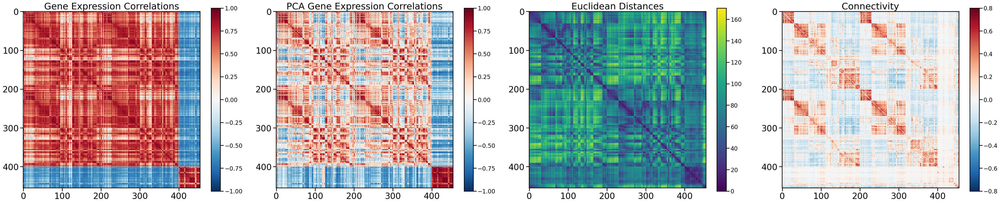

True SA_lambda: 27.59374933924562, True SA_inf: 0.30144955155953435
True SA_lambda_PCA: 52.44982564829603, True SA_inf_PCA: -0.24532693453522644
True coefs: [ 1.16374926e+00 -3.07176234e-02  3.41576765e-04 -1.15364351e-06]
True coefs_PCA: [ 1.14565837e+00 -3.37051128e-02  3.38523335e-04 -1.14630928e-06]


In [319]:
# Reload in brain data
X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix = load_and_plot_data(parcellation='S400', hemisphere='both', omit_subcortical=False, 
                      sort_genes='expression', impute_strategy='mirror_interpolate', null_model='none', fontsize=26)

features, features_cortex, features_subcortex = subset_brain_data(X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix)
dist_vec = features['distances']
CGE_vec = features['CGE']
PCA_CGE_vec = features['PCA_CGE']


true_SA_lambda, true_SA_inf = compute_exponential_distance_decay(dist_vec, CGE_vec, bin_size_mm=5)
true_coefs = compute_distance_decay_poly3(dist_vec, CGE_vec, bin_size_mm=5)
true_SA_lambda_PCA, true_SA_inf_PCA = compute_exponential_distance_decay(dist_vec, PCA_CGE_vec, bin_size_mm=5)
true_coefs_PCA = compute_distance_decay_poly3(dist_vec, PCA_CGE_vec, bin_size_mm=5)
print(f"True SA_lambda: {true_SA_lambda}, True SA_inf: {true_SA_inf}")
print(f"True SA_lambda_PCA: {true_SA_lambda_PCA}, True SA_inf_PCA: {true_SA_inf_PCA}")
print(f"True coefs: {true_coefs}")
print(f"True coefs_PCA: {true_coefs_PCA}")

In [320]:
spins_df.iloc[:, 2:].describe()

,cortical_cost,subcortical_cost,total_cost,SA_lambda,SA_inf,poly_a1,poly_a2,poly_a3,poly_a4,SA_lambda_PCA,SA_inf_PCA,poly_a1_PCA,poly_a2_PCA,poly_a3_PCA,poly_a4_PCA
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1.000000e+03,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1.000000e+03
mean,13892.309726,2443.137967,16335.447693,17.714230,0.373777,0.944553,-0.021287,0.000215,-6.253058e-07,26.263411,0.003009,0.912280,-0.025645,0.000235,-6.840313e-07
std,1130.460986,584.321445,1370.475722,2.889085,0.037506,0.053809,0.003118,0.000050,2.250901e-07,5.900401,0.074018,0.054126,0.003682,0.000062,2.862457e-07
min,8319.420465,402.839603,9046.110837,12.379607,0.212865,0.768866,-0.033614,0.000100,-1.498302e-06,16.586924,-0.286632,0.738427,-0.037022,0.000068,-1.523929e-06
25%,13436.319811,2081.246750,15754.472239,15.579447,0.349178,0.909753,-0.023134,0.000181,-7.520045e-07,21.884916,-0.043932,0.876302,-0.028173,0.000190,-8.794476e-07
50%,14170.750747,2560.600601,16613.161373,17.213730,0.381324,0.946506,-0.021025,0.000208,-5.822989e-07,24.743433,0.019299,0.913390,-0.025601,0.000235,-6.701137e-07
75%,14625.137847,2922.098404,17242.061416,19.325285,0.403145,0.979607,-0.019217,0.000242,-4.739048e-07,29.528789,0.058291,0.948481,-0.023135,0.000275,-4.698277e-07
max,16275.629917,3244.515532,19135.242823,33.487967,0.441354,1.132263,-0.013344,0.000413,-1.359490e-07,52.268719,0.136029,1.078518,-0.015572,0.000423,8.874392e-08


In [321]:
spins_df

,cortical_spins,subcortical_spins,cortical_cost,subcortical_cost,total_cost,SA_lambda,SA_inf,poly_a1,poly_a2,poly_a3,poly_a4,SA_lambda_PCA,SA_inf_PCA,poly_a1_PCA,poly_a2_PCA,poly_a3_PCA,poly_a4_PCA
0,"[34, 35, 33, 102, 101, 99, 140, 152, 100, 174,...","[53, 52, 49, 51, 54, 50, 33, 34, 42, 48, 29, 4...",14676.201766,2342.839271,17019.041037,22.017654,0.298041,0.892056,-0.020372,0.000229,-7.939946e-07,39.069998,-0.164938,0.892085,-0.026995,0.000288,-1.034092e-06
1,"[31, 33, 135, 171, 162, 154, 35, 98, 158, 101,...","[32, 55, 53, 52, 31, 51, 8, 34, 6, 54, 10, 50,...",14223.071041,3079.720650,17302.791691,14.342431,0.419686,0.895892,-0.017695,0.000150,-3.050474e-07,18.690197,0.100440,0.815554,-0.019567,0.000131,-1.852663e-07
2,"[165, 166, 124, 167, 114, 125, 133, 119, 113, ...","[54, 55, 32, 46, 48, 50, 3, 29, 5, 31, 30, 34,...",14066.498745,2193.130687,16259.629432,20.711310,0.331661,0.990390,-0.023210,0.000244,-7.754920e-07,34.530601,-0.104178,0.969185,-0.029299,0.000301,-1.024482e-06
3,"[48, 106, 110, 109, 55, 199, 179, 194, 54, 182...","[2, 55, 0, 49, 54, 50, 29, 3, 13, 51, 4, 47, 9...",13520.685713,2364.827011,15885.512724,17.938817,0.376869,0.955965,-0.020002,0.000183,-4.740132e-07,25.958393,0.007003,0.908789,-0.023540,0.000193,-4.967189e-07
4,"[185, 184, 64, 86, 87, 63, 85, 187, 61, 58, 56...","[4, 53, 46, 50, 28, 42, 13, 0, 34, 47, 49, 48,...",13896.760066,3108.012640,17004.772706,16.781932,0.386511,0.946094,-0.020804,0.000202,-5.556576e-07,25.778299,0.011122,0.959338,-0.027698,0.000260,-7.725980e-07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,"[65, 58, 87, 62, 56, 110, 52, 108, 84, 59, 66,...","[5, 51, 46, 50, 34, 0, 8, 42, 13, 47, 53, 49, ...",14684.891431,2952.404960,17637.296391,14.218340,0.417515,0.901402,-0.019131,0.000178,-4.339337e-07,20.197168,0.082372,0.898447,-0.025356,0.000224,-5.798865e-07
996,"[50, 111, 110, 62, 199, 193, 59, 54, 82, 66, 8...","[2, 42, 43, 51, 4, 1, 34, 5, 33, 0, 53, 47, 31...",14857.622948,2418.224867,17275.847815,15.283271,0.406544,0.949773,-0.020664,0.000193,-4.847809e-07,21.631959,0.058740,0.913274,-0.024949,0.000212,-5.387975e-07
997,"[100, 97, 171, 99, 142, 98, 148, 134, 135, 101...","[34, 55, 53, 54, 48, 28, 7, 31, 6, 52, 32, 50,...",13831.256618,3137.596819,16968.853437,16.365579,0.393593,0.883028,-0.016372,0.000133,-2.710333e-07,23.392806,0.034408,0.832321,-0.020132,0.000148,-3.143651e-07
998,"[124, 119, 142, 120, 96, 99, 125, 97, 123, 122...","[30, 46, 7, 47, 13, 34, 31, 54, 6, 8, 53, 51, ...",12176.498848,2698.761610,14875.260458,17.211240,0.397486,0.969762,-0.020963,0.000195,-5.029283e-07,23.630373,0.050748,0.920128,-0.024110,0.000196,-4.740696e-07


Standardize each column and compute the residuals to the true param values. Then compute an overall error for SA and for poly params, which describes how much each null spin test matches the SA decay curves of the true data

In [322]:
# Standardize all numeric columns (excluding cortical_spins and subcortical_spins) into new dataframe
numeric_cols = spins_df.columns[5:]  # Get all columns after first two
standardized_df = spins_df.copy()
standardized_df[numeric_cols] = (spins_df[numeric_cols] - spins_df[numeric_cols].mean()) / spins_df[numeric_cols].std()
# Standardize true parameters using same mean/std as spin nulls
true_SA_lambda_std = (true_SA_lambda - spins_df['SA_lambda'].mean()) / spins_df['SA_lambda'].std()
true_SA_inf_std = (true_SA_inf - spins_df['SA_inf'].mean()) / spins_df['SA_inf'].std()
true_SA_lambda_PCA_std = (true_SA_lambda_PCA - spins_df['SA_lambda_PCA'].mean()) / spins_df['SA_lambda_PCA'].std()
true_SA_inf_PCA_std = (true_SA_inf_PCA - spins_df['SA_inf_PCA'].mean()) / spins_df['SA_inf_PCA'].std()

# Standardize polynomial coefficients
true_coefs_std = (true_coefs - spins_df[['poly_a1', 'poly_a2', 'poly_a3', 'poly_a4']].mean()) / spins_df[['poly_a1', 'poly_a2', 'poly_a3', 'poly_a4']].std()
true_coefs_PCA_std = (true_coefs_PCA - spins_df[['poly_a1_PCA', 'poly_a2_PCA', 'poly_a3_PCA', 'poly_a4_PCA']].mean()) / spins_df[['poly_a1_PCA', 'poly_a2_PCA', 'poly_a3_PCA', 'poly_a4_PCA']].std()

print("Standardized exponential parameters:")
print(f"SA_lambda: {true_SA_lambda_std:.3f}")
print(f"SA_inf: {true_SA_inf_std:.3f}")
print(f"SA_lambda_PCA: {true_SA_lambda_PCA_std:.3f}")
print(f"SA_inf_PCA: {true_SA_inf_PCA_std:.3f}")

print("\nStandardized polynomial coefficients:")
print(f"poly_a1: {true_coefs_std[0]:.3f}")
print(f"poly_a2: {true_coefs_std[1]:.3f}") 
print(f"poly_a3: {true_coefs_std[2]:.3f}")
print(f"poly_a4: {true_coefs_std[3]:.3f}")

print("\nStandardized PCA polynomial coefficients:")
print(f"poly_a1_PCA: {true_coefs_PCA_std[0]:.3f}")
print(f"poly_a2_PCA: {true_coefs_PCA_std[1]:.3f}")
print(f"poly_a3_PCA: {true_coefs_PCA_std[2]:.3f}") 
print(f"poly_a4_PCA: {true_coefs_PCA_std[3]:.3f}")


# Extract numeric columns as numpy array
null_params = standardized_df[numeric_cols].to_numpy()

# Create array of true standardized values in same order as numeric columns
true_std_vals = np.array([
    true_SA_lambda_std,
    true_SA_inf_std, 
    true_SA_lambda_PCA_std,
    true_SA_inf_PCA_std,
    true_coefs_std[0],
    true_coefs_std[1],
    true_coefs_std[2], 
    true_coefs_std[3],
    true_coefs_PCA_std[0],
    true_coefs_PCA_std[1],
    true_coefs_PCA_std[2],
    true_coefs_PCA_std[3]
])

# Compute residuals (differences) between each null spin and true values
residuals = null_params - true_std_vals[np.newaxis, :]

# Calculate summed absolute residuals for each parameter group 
# (L1 error i.e. sum of absolute differences)
standardized_SA_error = np.abs(residuals[:, 0:2]).sum(axis=1)  # SA_lambda and SA_inf
standardized_poly_error = np.abs(residuals[:, 4:8]).sum(axis=1)  # poly_a1 through poly_a4
standardized_SA_PCA_error = np.abs(residuals[:, 2:4]).sum(axis=1)  # SA_lambda_PCA and SA_inf_PCA
standardized_poly_PCA_error = np.abs(residuals[:, 8:12]).sum(axis=1)  # poly_a1_PCA through poly_a4_PCA

# Add error columns to spins_df
spins_df['standardized_SA_error'] = standardized_SA_error
spins_df['standardized_poly_error'] = standardized_poly_error 
spins_df['standardized_SA_PCA_error'] = standardized_SA_PCA_error
spins_df['standardized_poly_PCA_error'] = standardized_poly_PCA_error



Standardized exponential parameters:
SA_lambda: 3.420
SA_inf: -1.928
SA_lambda_PCA: 4.438
SA_inf_PCA: -3.355

Standardized polynomial coefficients:
poly_a1: 4.074
poly_a2: -3.025
poly_a3: 2.550
poly_a4: -2.347

Standardized PCA polynomial coefficients:
poly_a1_PCA: 4.312
poly_a2_PCA: -2.189
poly_a3_PCA: 1.667
poly_a4_PCA: -1.615


In [323]:
# Find and display the row with minimum standardized SA error
min_SA_error_row = spins_df.loc[spins_df['standardized_SA_error'].idxmin()]
print("Row with lowest standardized SA error:")
print(min_SA_error_row)

'''
True SA_lambda: 27.59374933924562, True SA_inf: 0.30144955155953435
True SA_lambda_PCA: 52.44982564829603, True SA_inf_PCA: -0.24532693453522644
True coefs: [ 1.16374926e+00 -3.07176234e-02  3.41576765e-04 -1.15364351e-06]
True coefs_PCA: [ 1.14565837e+00 -3.37051128e-02  3.38523335e-04 -1.14630928e-06]
'''

Row with lowest standardized SA error:
cortical_spins                 [1, 6, 4, 0, 2, 69, 12, 68, 5, 3, 10, 7, 15, 1...
subcortical_spins              [0, 33, 2, 29, 1, 5, 6, 7, 8, 3, 10, 11, 12, 1...
cortical_cost                                                        9868.096901
subcortical_cost                                                      612.102793
total_cost                                                          10480.199694
SA_lambda                                                              26.171549
SA_inf                                                                  0.297115
poly_a1                                                                 1.096968
poly_a2                                                                -0.028375
poly_a3                                                                 0.000318
poly_a4                                                                -0.000001
SA_lambda_PCA                                                         

'\nTrue SA_lambda: 27.59374933924562, True SA_inf: 0.30144955155953435\nTrue SA_lambda_PCA: 52.44982564829603, True SA_inf_PCA: -0.24532693453522644\nTrue coefs: [ 1.16374926e+00 -3.07176234e-02  3.41576765e-04 -1.15364351e-06]\nTrue coefs_PCA: [ 1.14565837e+00 -3.37051128e-02  3.38523335e-04 -1.14630928e-06]\n'

In [324]:
spins_df = spins_df[['cortical_spins', 'subcortical_spins', 'cortical_cost', 'subcortical_cost', 'total_cost', 
          'standardized_SA_error', 'standardized_poly_error', 'standardized_SA_PCA_error', 'standardized_poly_PCA_error',
          'SA_lambda', 'SA_inf', 'SA_lambda_PCA', 'SA_inf_PCA', 'poly_a1', 'poly_a2', 'poly_a3', 'poly_a4',
          'poly_a1_PCA', 'poly_a2_PCA', 'poly_a3_PCA', 'poly_a4_PCA']]

In [325]:
spins_df

,cortical_spins,subcortical_spins,cortical_cost,subcortical_cost,total_cost,standardized_SA_error,standardized_poly_error,standardized_SA_PCA_error,standardized_poly_PCA_error,SA_lambda,...,SA_lambda_PCA,SA_inf_PCA,poly_a1,poly_a2,poly_a3,poly_a4,poly_a1_PCA,poly_a2_PCA,poly_a3_PCA,poly_a4_PCA
0,"[34, 35, 33, 102, 101, 99, 140, 152, 100, 174,...","[53, 52, 49, 51, 54, 50, 33, 34, 42, 48, 29, 4...",14676.201766,2342.839271,17019.041037,2.020939,6.524261,9.062220,7.718377,22.017654,...,39.069998,-0.164938,0.892056,-0.020372,0.000229,-7.939946e-07,0.892085,-0.026995,0.000288,-1.034092e-06
1,"[31, 33, 135, 171, 162, 154, 35, 98, 158, 101,...","[32, 55, 53, 52, 31, 51, 8, 34, 6, 54, 10, 50,...",14223.071041,3079.720650,17302.791691,7.739180,17.327764,9.849295,16.639392,14.342431,...,18.690197,0.100440,0.895892,-0.017695,0.000150,-3.050474e-07,0.815554,-0.019567,0.000131,-1.852663e-07
2,"[165, 166, 124, 167, 114, 125, 133, 119, 113, ...","[54, 55, 32, 46, 48, 50, 3, 29, 5, 31, 30, 34,...",14066.498745,2193.130687,16259.629432,3.187752,7.889415,6.324602,5.481857,20.711310,...,34.530601,-0.104178,0.990390,-0.023210,0.000244,-7.754920e-07,0.969185,-0.029299,0.000301,-1.024482e-06
3,"[48, 106, 110, 109, 55, 199, 179, 194, 54, 182...","[2, 55, 0, 49, 54, 50, 29, 3, 13, 51, 4, 47, 9...",13520.685713,2364.827011,15885.512724,5.352753,13.405419,7.993074,11.752289,17.938817,...,25.958393,0.007003,0.955965,-0.020002,0.000183,-4.740132e-07,0.908789,-0.023540,0.000193,-4.967189e-07
4,"[185, 184, 64, 86, 87, 63, 85, 187, 61, 58, 56...","[4, 53, 46, 50, 28, 42, 13, 0, 34, 47, 49, 48,...",13896.760066,3108.012640,17004.772706,6.010256,12.749899,7.919451,7.642180,16.781932,...,25.778299,0.011122,0.946094,-0.020804,0.000202,-5.556576e-07,0.959338,-0.027698,0.000260,-7.725980e-07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,"[65, 58, 87, 62, 56, 110, 52, 108, 84, 59, 66,...","[5, 51, 46, 50, 34, 0, 8, 42, 13, 47, 53, 49, ...",14684.891431,2952.404960,17637.296391,7.724251,15.685627,9.286314,10.664205,14.218340,...,20.197168,0.082372,0.901402,-0.019131,0.000178,-4.339337e-07,0.898447,-0.025356,0.000224,-5.798865e-07
996,"[50, 111, 110, 62, 199, 193, 59, 54, 82, 66, 8...","[2, 42, 43, 51, 4, 1, 34, 5, 33, 0, 53, 47, 31...",14857.622948,2418.224867,17275.847815,7.063126,14.601040,7.895978,10.828500,15.283271,...,21.631959,0.058740,0.949773,-0.020664,0.000193,-4.847809e-07,0.913274,-0.024949,0.000212,-5.387975e-07
997,"[100, 97, 171, 99, 142, 98, 148, 134, 135, 101...","[34, 55, 53, 54, 48, 28, 7, 31, 6, 52, 32, 50,...",13831.256618,3137.596819,16968.853437,6.343195,16.116874,10.512883,15.454354,16.365579,...,23.392806,0.034408,0.883028,-0.016372,0.000133,-2.710333e-07,0.832321,-0.020132,0.000148,-3.143651e-07
998,"[124, 119, 142, 120, 96, 99, 125, 97, 123, 122...","[30, 46, 7, 47, 13, 34, 31, 54, 6, 8, 53, 51, ...",12176.498848,2698.761610,14875.260458,6.154286,14.017681,7.428544,11.415112,17.211240,...,23.630373,0.050748,0.969762,-0.020963,0.000195,-5.029283e-07,0.920128,-0.024110,0.000196,-4.740696e-07


In [326]:
spins_df.to_csv('1000_null_spins.csv', index=False)